In [1]:
from astropy.io import fits
import glob
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib
from scipy import fftpack

%matplotlib notebook

In [11]:
%ls -d /opt/Data/*


/opt/Data/SB167-2020-08-12T22:15:50-22:18:59/
/opt/Data/SB167-2020-08-12T22:15:50-22:18:59.ms/
/opt/Data/SB167-2020-08-12T22:15:50-22:18:59.vis
/opt/Data/SB186-2020-08-12T21:24:50-21:27:59.ms/
/opt/Data/SB235-2020-08-12T22:15:50-22:18:59/
/opt/Data/SB235-2020-08-12T22:15:50-22:18:59.ms/
/opt/Data/SB235-2020-08-12T22:15:50-22:18:59.vis
/opt/Data/SB256-2020-08-12T21:27:50-21:30:59-pols/
/opt/Data/SB294-2020-10-13T23:33:00-23:36:10.vis
/opt/Data/SB298-2020-10-13T23:33:00-23:36:10.vis
/opt/Data/SB301-2020-10-13T23:33:00-23:36:10.vis
/opt/Data/SB304-2020-10-13T23:33:00-23:36:10.vis
/opt/Data/SB308-2020-10-13T23:33:00-23:36:10.vis
/opt/Data/imgs/


In [2]:
images = sorted(glob.glob("/scratch/mkuiack/lookhere/img_20200813T2490-2550/*image.fits"))
print images

# dirtys =  sorted(glob.glob("lookhere/all_im/*-*--00*-dirty.fits"))
# print dirtys
# print len(images)/3.
# images.append(glob.glob("lookhere/img_SB318/A12_test-000?-image-pb.fits") )

['/scratch/mkuiack/lookhere/img_20200813T2490-2550/00000_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00001_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00002_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00003_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00004_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00005_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00006_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00007_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00008_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00009_167-20200813T2490-2550-image.fits', '/scratch/mkuiack/lookhere/img_20200813T2490-2550/00010_167-20200813T2490-2550-

In [20]:
new_names = [os.path.dirname(x)+"/"+os.path.basename(x).split("-")[0].zfill(3)+"-"+os.path.basename(x).split("-")[-2]+"-"+os.path.basename(x).split("-")[-1] for x in images]

In [24]:
for ix in range(len(new_names)):
    os.rename(images[ix], new_names[ix])

In [12]:
os.path.basename(x).split("-")[0]+"-"+os.path.basename(x).split("-")[-2]+"-"+os.path.basename(x).split("-")[-1]

'99-0004-image.fits'

In [7]:
for i,j in zip(np.arange(0,len(images)-4,5), np.arange(5,len(images)+1, 5)):
    print i, j

0 5
5 10


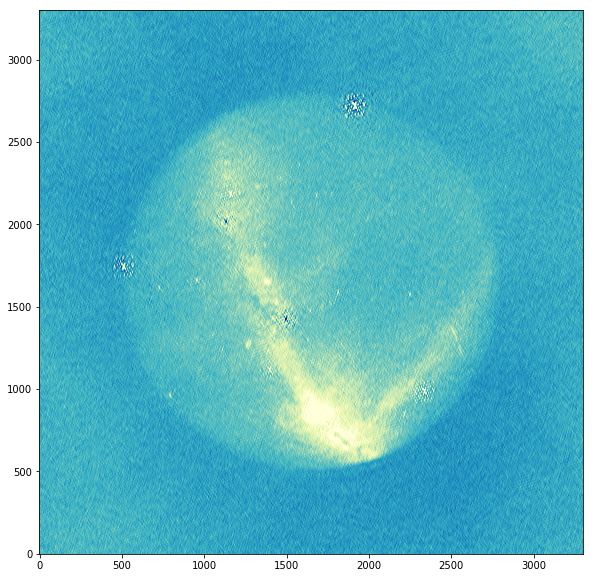

In [12]:
data, f=fits.getdata(images[54],header=True)
plt.figure(figsize=(10,10))


vmin=np.mean(data[0,0,:,:])-5*np.std(data[0,0,:,:])
vmax=np.mean(data[0,0,:,:])+5*np.std(data[0,0,:,:])

plt.imshow(data[0,0,:,:], 
           vmin=vmin, vmax=vmax, origin="lower", cmap="YlGnBu_r")
# plt.xticks([])
# plt.yticks([])
plt.show()

In [3]:

im_stack = np.nan*np.zeros([2300,2300,len(images)])

for i in range(len(images)):
    data, f=fits.getdata(images[i],header=True)
    STD = np.std(data[0,0,:,:])
    if STD < 500. and STD > 1.:
        im_stack[:,:,i] = data[0,0,:,:]
        
        
# dirt_stack = np.nan*np.zeros([3300,3300,len(dirtys)])

# for i in range(len(dirtys)):
#     data, f=fits.getdata(dirtys[i],header=True)
#     if np.std(data[0,0,:,:][900:2400,900:2400]) < 50.:
#         dirt_stack[:,:,i] = data[0,0,:,:]

([], <a list of 0 Text yticklabel objects>)

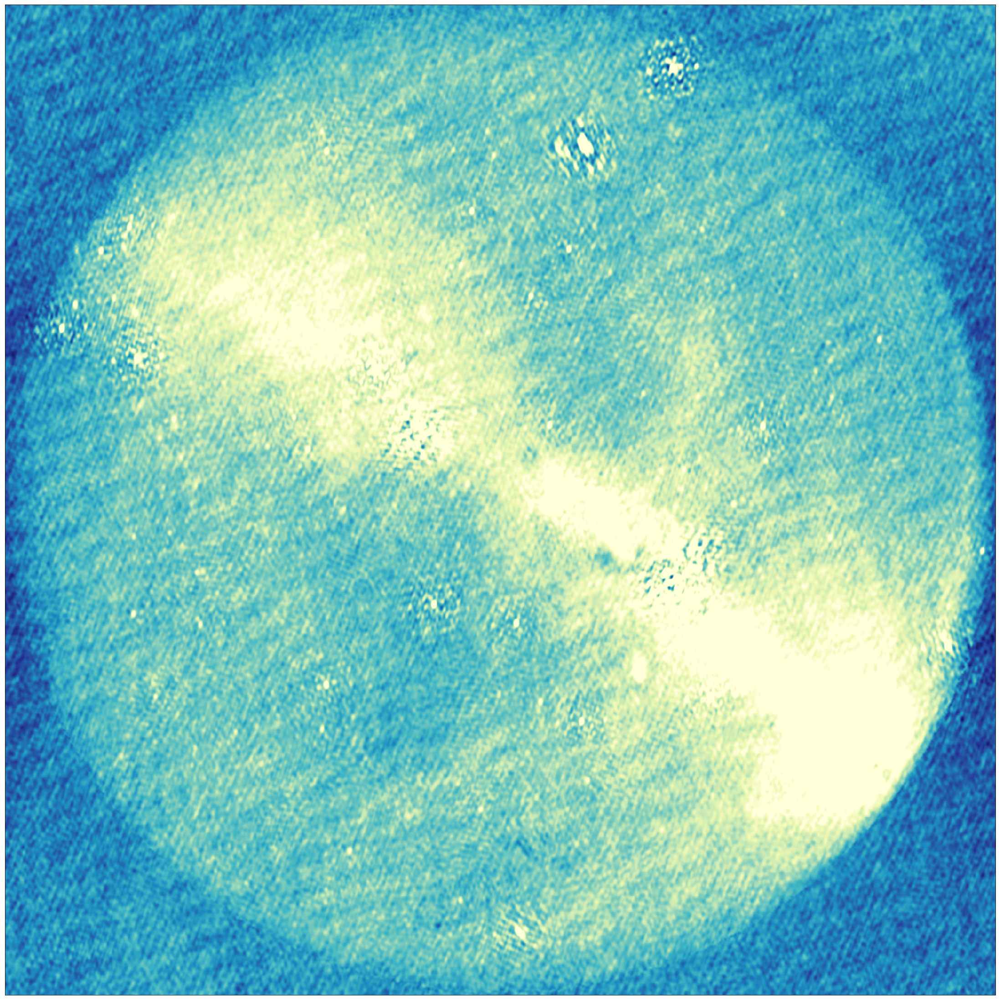

In [5]:
plt.figure(figsize=(40,40))
plt.imshow(np.nanmean(im_stack, axis=2), 
           vmin=-100,vmax=100, origin="lower", cmap="YlGnBu_r")
plt.xticks([])
plt.yticks([])


([], <a list of 0 Text yticklabel objects>)

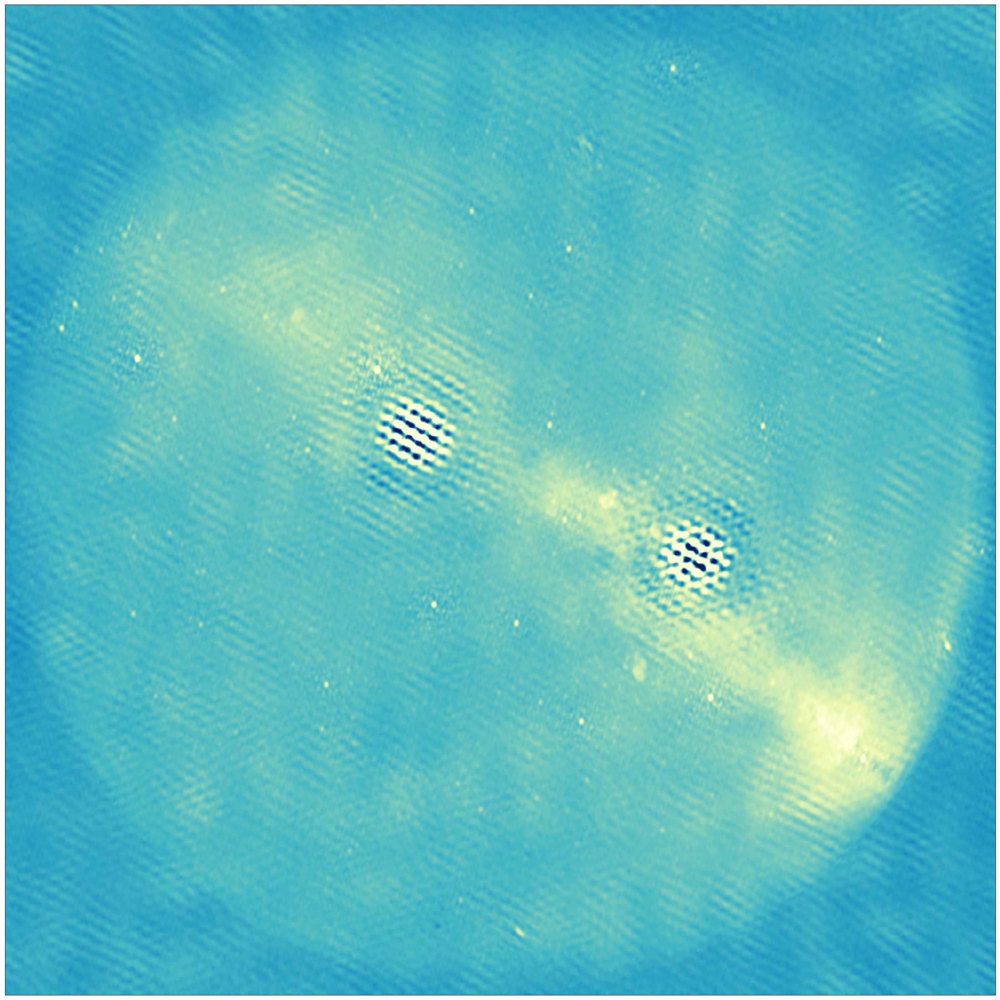

In [25]:
plt.figure(figsize=(40,40))
plt.imshow(np.nanmean(im_stack, axis=2), 
           vmin=-300,vmax=300, origin="lower", cmap="YlGnBu_r")
plt.xticks([])
plt.yticks([])

In [ ]:
$HOME/soft/src/aartfaac2ms/build/afedit -trim-start 2490 -trim-end 2550 /opt/Archive/202008122000/SB167-202008122000-lba_inner.vis  /opt/Archive/202008122000/SB167-20200813T2490-2550.vis

<IPython.core.display.Javascript object>


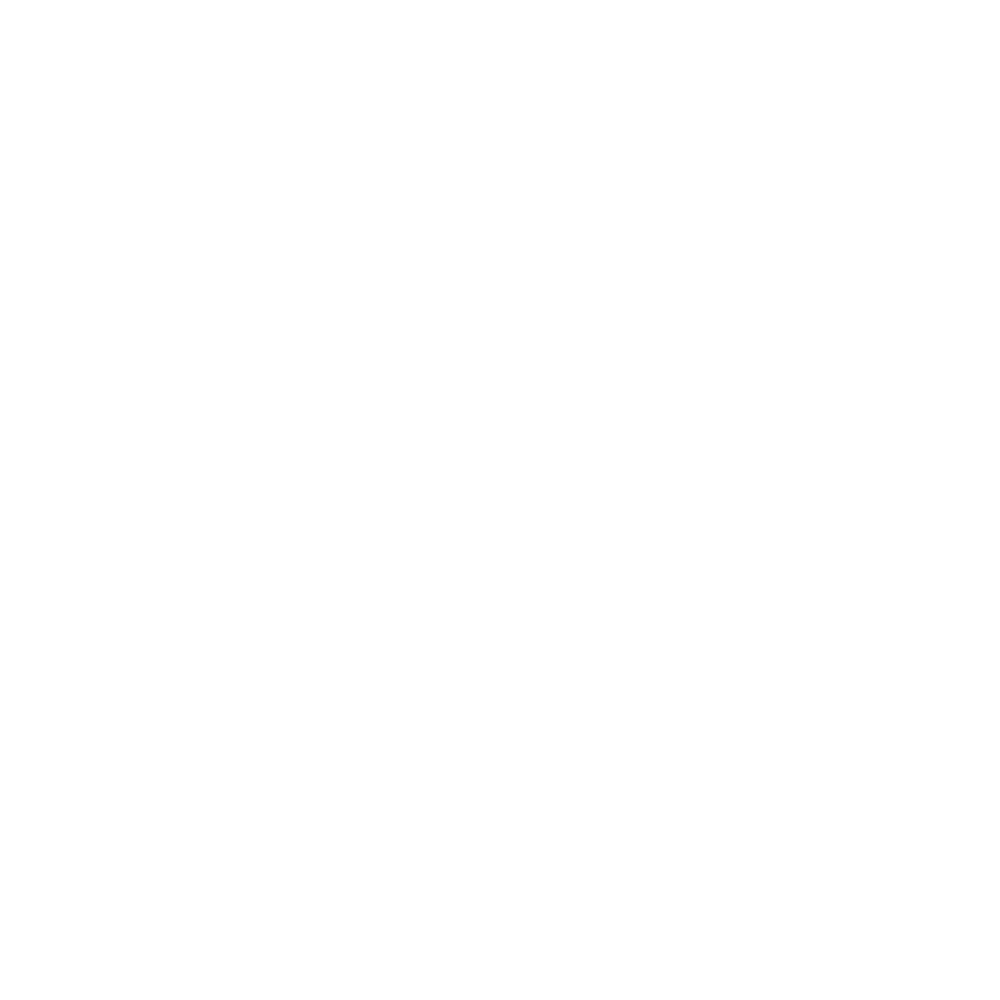

<IPython.core.display.Javascript object>


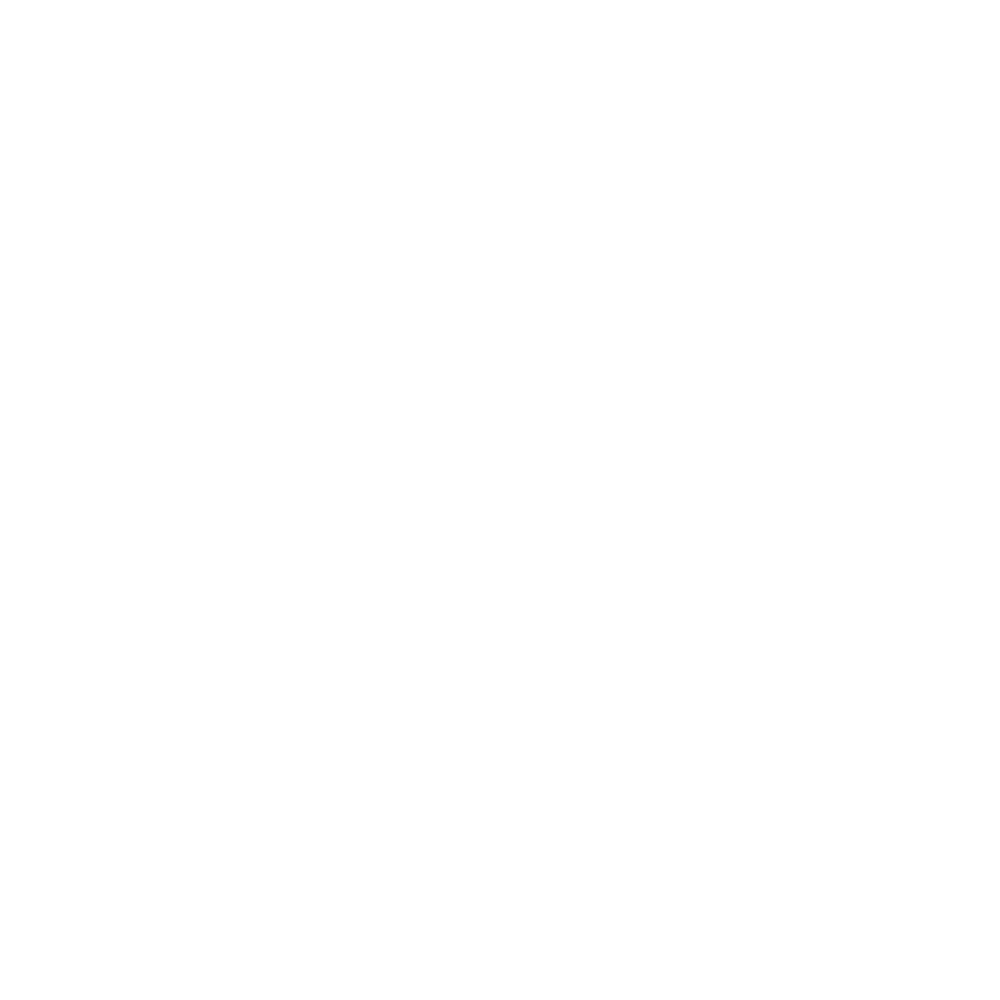

<IPython.core.display.Javascript object>


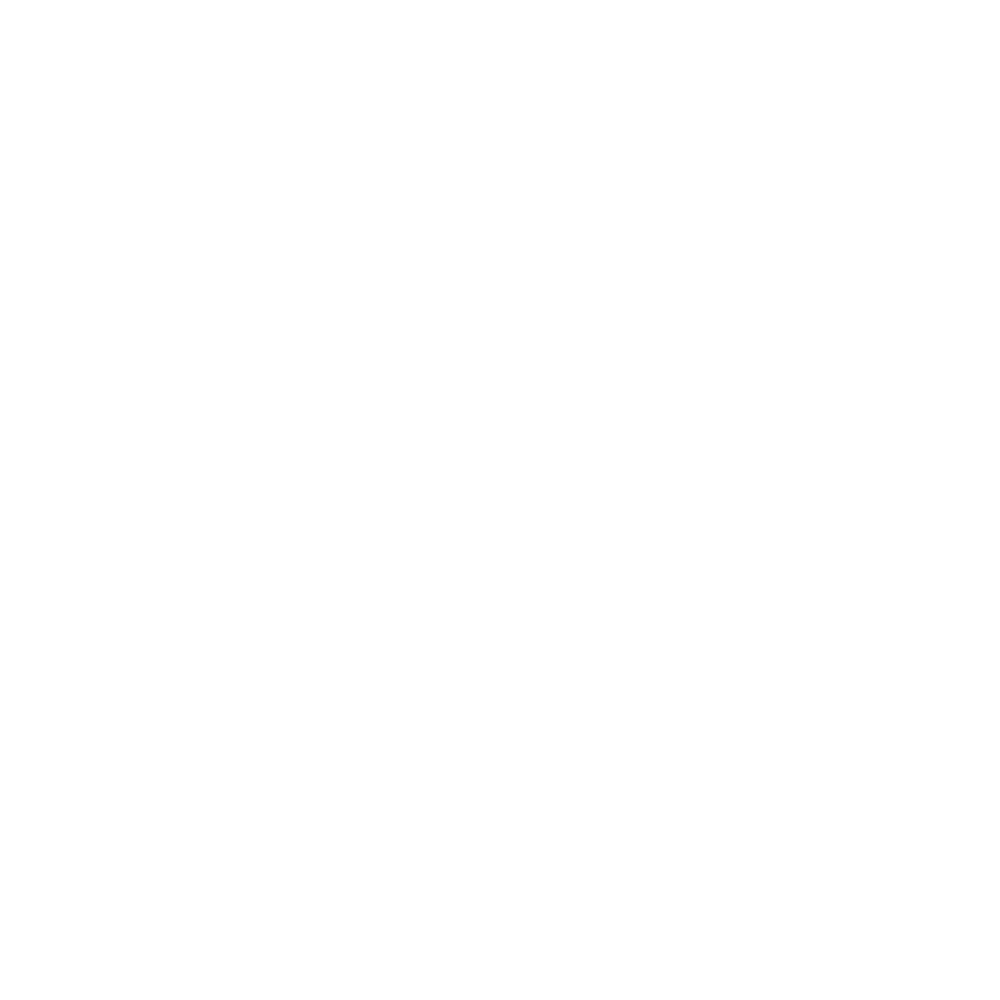

<IPython.core.display.Javascript object>


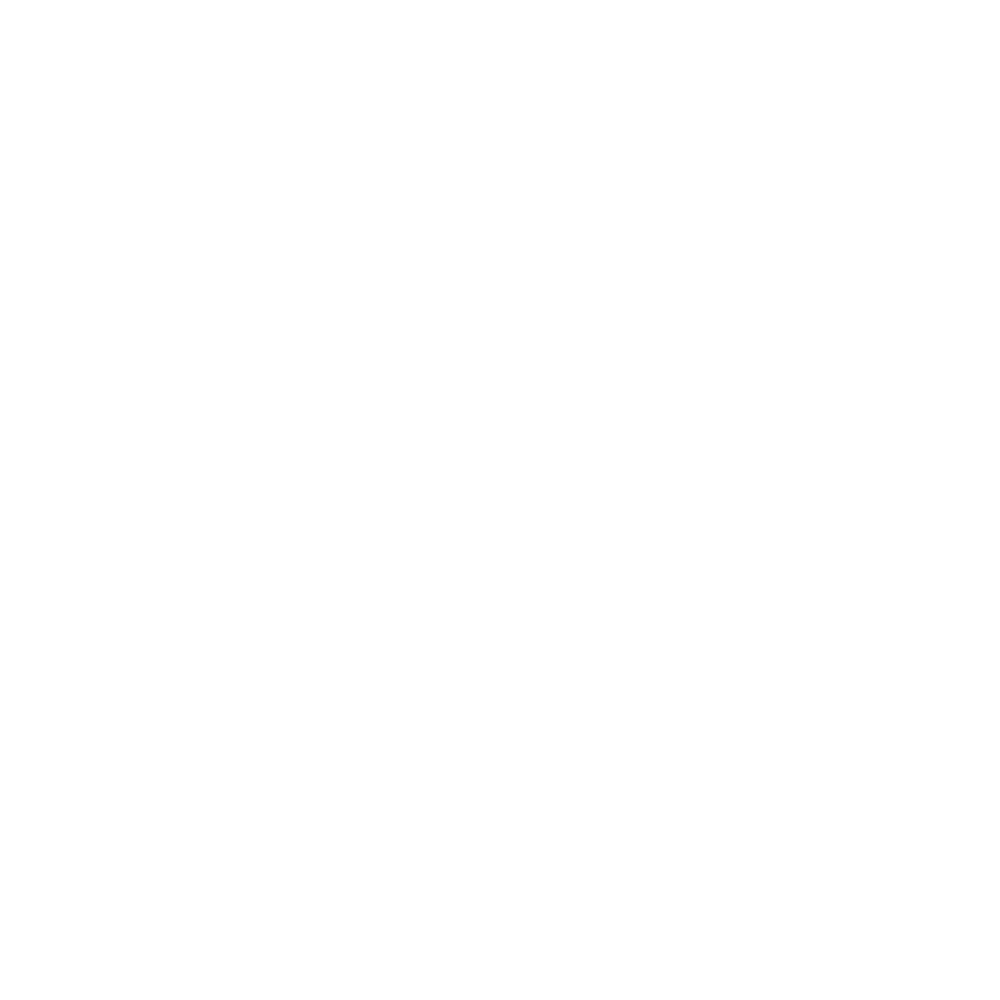

<IPython.core.display.Javascript object>


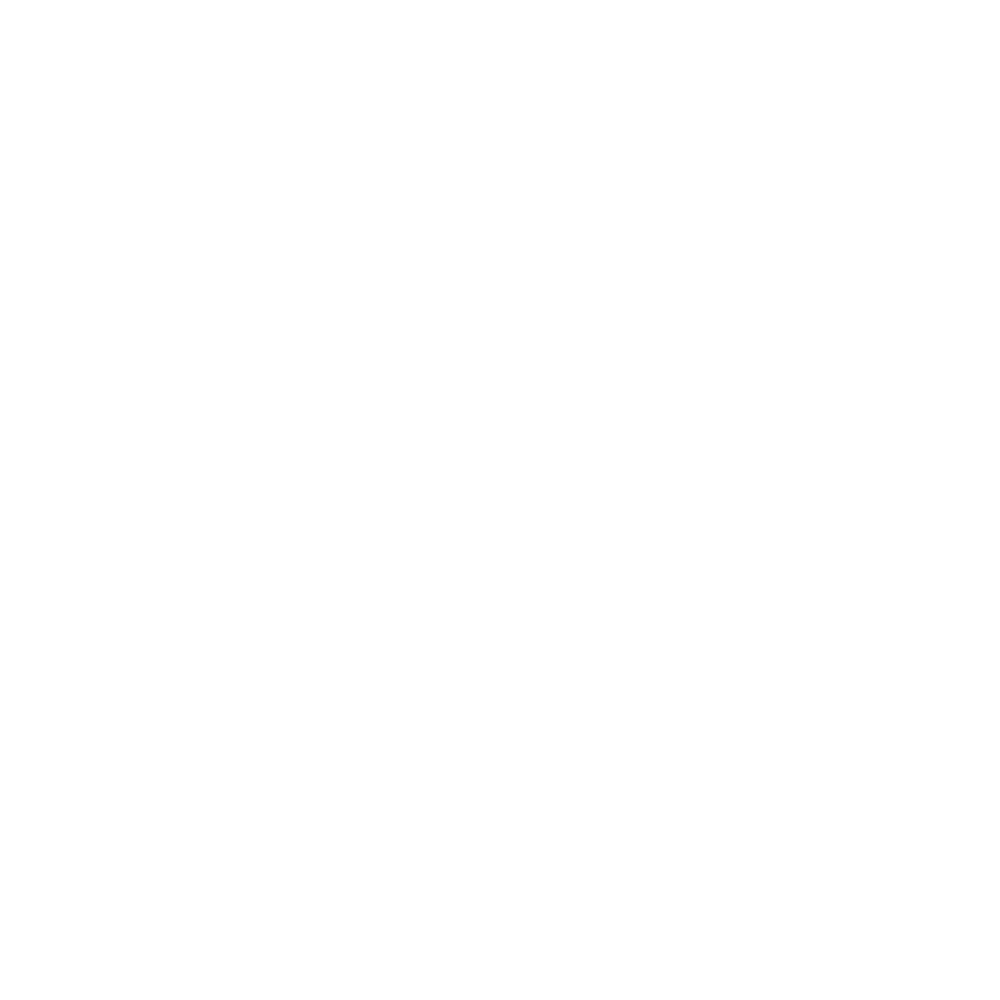

<IPython.core.display.Javascript object>


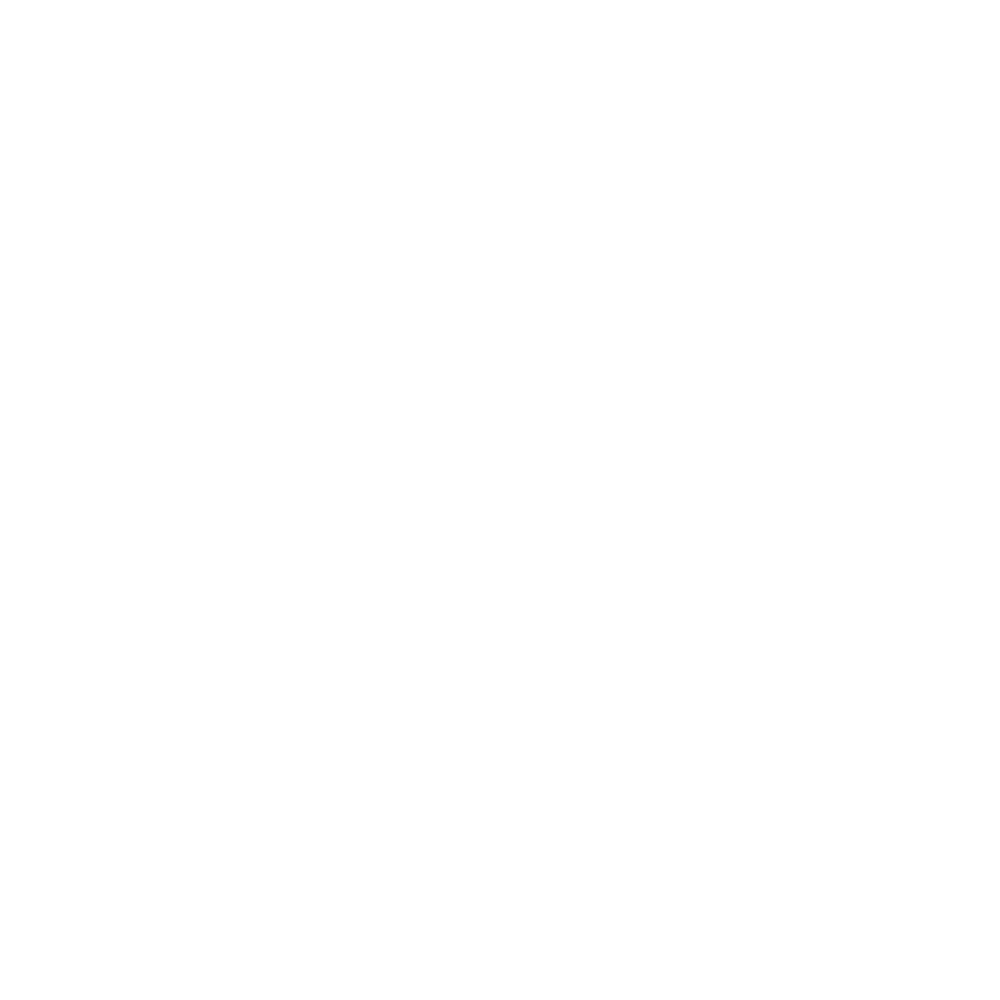

KeyboardInterrupt: 

In [27]:
for i,j in zip(np.arange(0,len(images)-4,5), 
               np.arange(5,len(images)+1, 5)):
    
    
    im_slice = images[i:j]
    im_stack = np.nan*np.zeros([3300,3300,len(im_slice)])
    
    for k in range(len(im_slice)):
        data, f=fits.getdata(im_slice[k],header=True)
        if np.std(data[0,0,:,:][900:2400,900:2400]) < 70.:
            im_stack[:,:,k] = data[0,0,:,:]
            
    plt.figure(figsize=(10,10))
    plt.title(im_slice[0])
    plt.imshow(np.nanmean(im_stack, axis=2)[400:2900,400:2900], 
               vmin=-70,vmax=70, origin="lower", cmap="YlGnBu_r")
    plt.xticks([])
    plt.yticks([])
    plt.show()

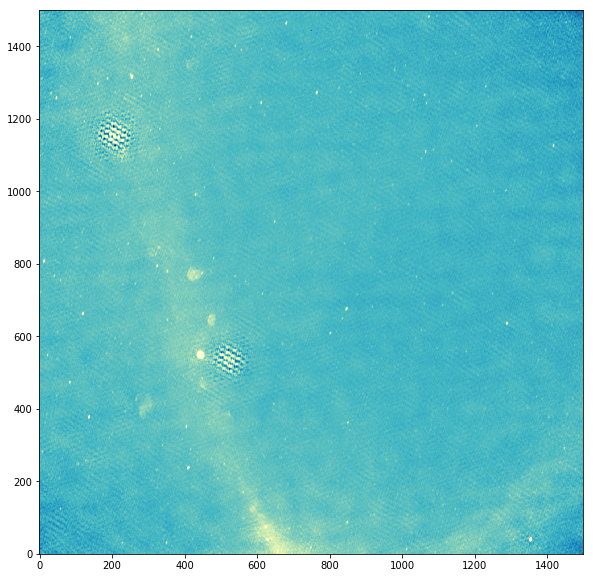

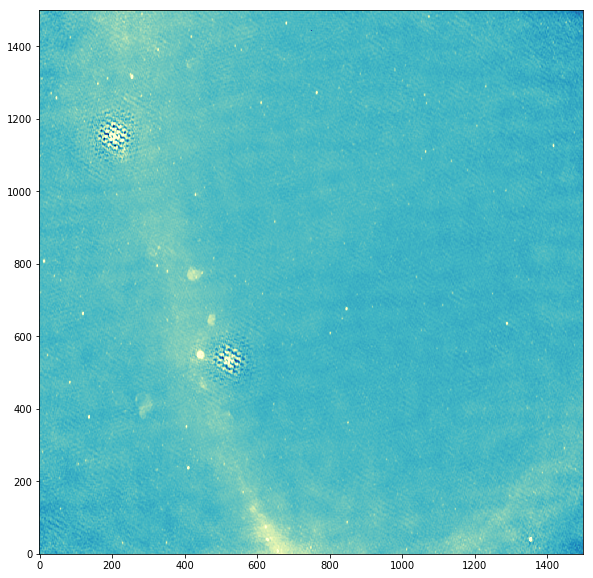

In [4]:
for i in np.arange(0,len(images),3)+1:
    plt.figure(figsize=(10,10))
    plt.imshow(im_stack[:,:,i][900:2400,900:2400], 
               vmin=-70,vmax=70, origin="lower", cmap="YlGnBu_r")
    
    
plt.figure(figsize=(10,10))
plt.imshow(np.nanmean(im_stack, axis=2)[900:2400,900:2400], vmin=-70,vmax=70, origin="lower", cmap="YlGnBu_r")

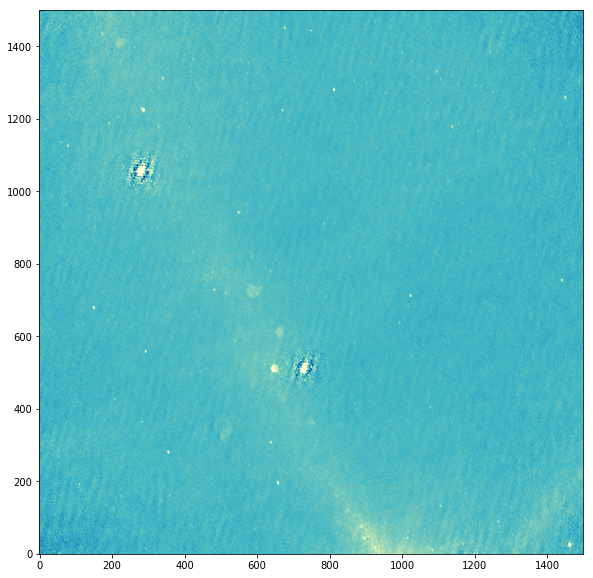

In [42]:

plt.figure(figsize=(10,10))
plt.imshow(np.nanmean(im_stack, axis=2)[900:2400,900:2400], vmin=-70,vmax=70, origin="lower", cmap="YlGnBu_r")

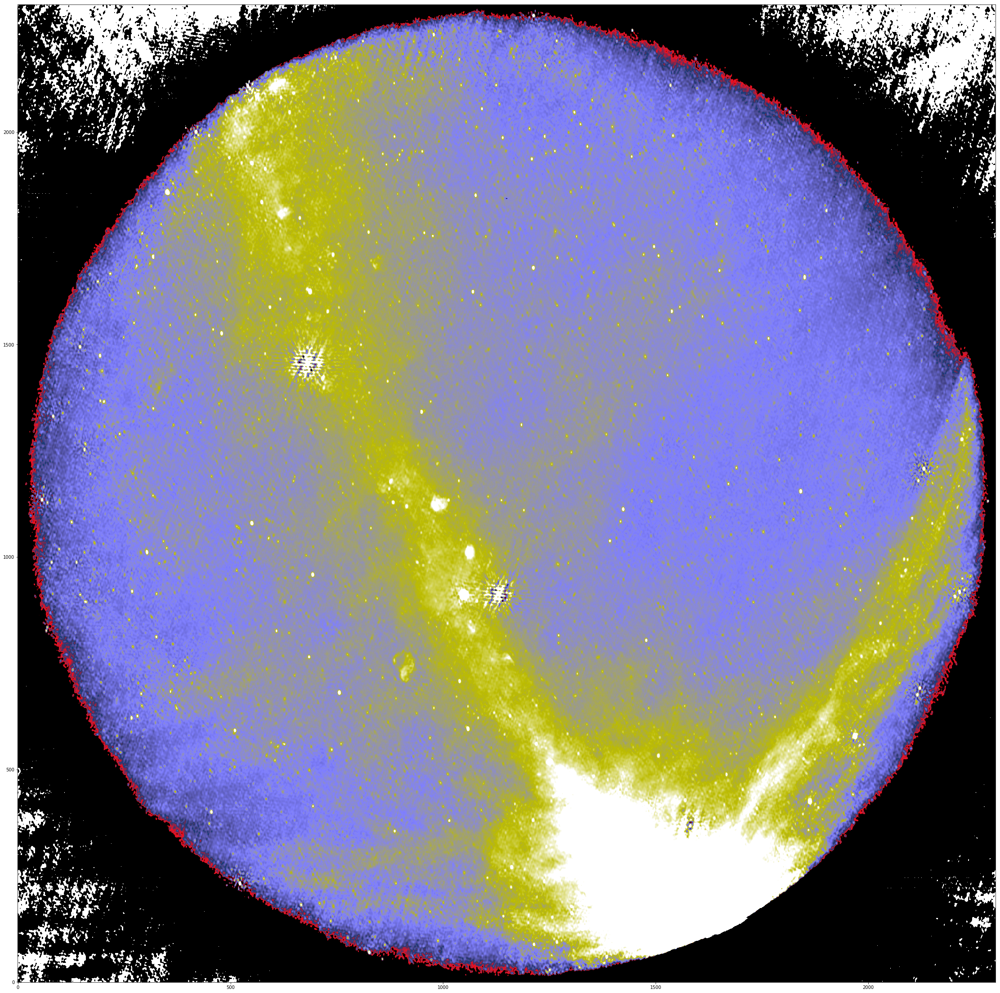

In [19]:
plt.figure(figsize=(40,40))
vmin = np.nanmean(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])\
    -11*np.nanstd(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])
vmax = np.nanmean(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])\
    +10*np.nanstd(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])

plt.imshow(np.nanmean(im_stack[400:2900,400:2900,:], axis=2), 
           vmin=vmin, vmax=vmax, origin="lower",
           cmap="gist_stern")# cmap="YlGnBu_r")#
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

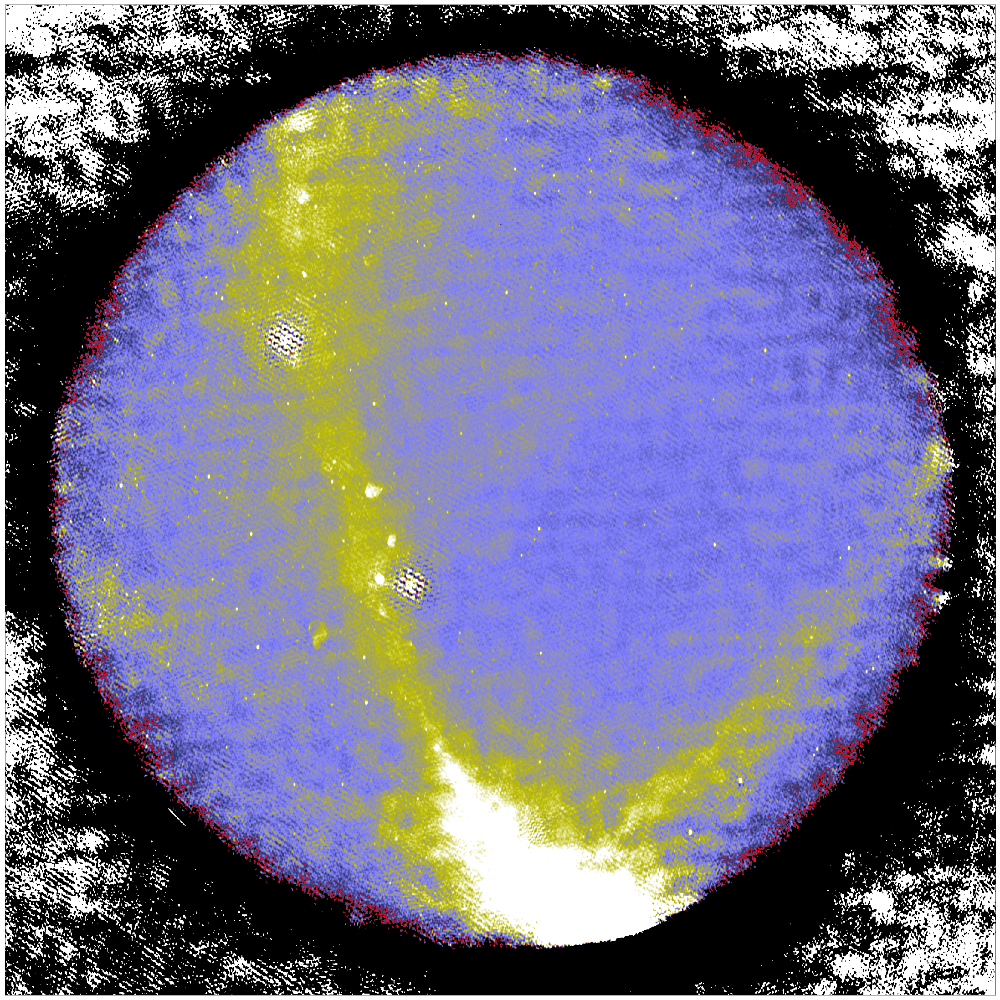

In [5]:
plt.figure(figsize=(40,40))
vmin = np.nanmean(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])\
    -9*np.nanstd(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])
vmax = np.nanmean(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])\
    +9*np.nanstd(np.nanmean(im_stack[900:2400,900:2400,:], axis=2)[900:2400,900:2400])

plt.imshow(np.nanmean(im_stack[400:2900,400:2900,:], axis=2), 
           vmin=vmin, vmax=vmax, origin="lower",
           cmap="gist_stern")# cmap="YlGnBu_r")#
plt.xticks([])
plt.yticks([])

In [21]:
f

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / number of bits per data pixel                  
NAXIS   =                    4 / number of data axes                            
NAXIS1  =                 2300 / length of data axis 1                          
NAXIS2  =                 2300 / length of data axis 2                          
NAXIS3  =                    1 / length of data axis 3                          
NAXIS4  =                    1 / length of data axis 4                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
BSCALE  =                   1.                                                  
BZERO   =                   0.                                                  
BUNIT   = 'JY/BEAM '        

## integrater 

In [7]:
import glob
[obs.split("_")[0] for obs in glob.glob("/opt/Archive/202007231100/*_all")]

['/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10',
 '/opt/Archive/202007231100/2020-07-23T11:48:00-11:51:10',
 '/opt/Archive/202007231100/2020-07-23T12:06:00-12:09:10',
 '/opt/Archive/202007231100/2020-07-23T15:12:00-15:15:10',
 '/opt/Archive/202007231100/2020-07-23T14:27:00-14:30:10',
 '/opt/Archive/202007231100/2020-07-23T15:06:00-15:09:10',
 '/opt/Archive/202007231100/2020-07-23T12:12:00-12:15:10',
 '/opt/Archive/202007231100/2020-07-23T16:03:00-16:06:10',
 '/opt/Archive/202007231100/2020-07-23T15:09:00-15:12:10',
 '/opt/Archive/202007231100/2020-07-23T12:21:00-12:24:10',
 '/opt/Archive/202007231100/2020-07-23T11:36:00-11:39:10',
 '/opt/Archive/202007231100/2020-07-23T13:30:00-13:33:10',
 '/opt/Archive/202007231100/2020-07-23T12:09:00-12:12:10',
 '/opt/Archive/202007231100/2020-07-23T11:54:00-11:57:10',
 '/opt/Archive/202007231100/2020-07-23T16:36:00-16:39:10',
 '/opt/Archive/202007231100/2020-07-23T14:30:00-14:33:10',
 '/opt/Archive/202007231100/2020-07-23T15:33:00-15:36:10

In [15]:

SLICES = [obs.split("_")[0] for obs in glob.glob("/opt/Archive/202007231100/*_all")]
all_std = []

for _slice in SLICES[:2]:
    print _slice
    images = sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*fits".format(_slice,_slice)))
    times = np.unique([os.path.basename(i).split("-")[2] for i in images])
    
    for step in times:
        step_imgs = sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*{}*fits".format(_slice,_slice, step)))
        print step, "num images:", len(step_imgs)


        im_stack = np.nan*np.zeros([2300,2300,len(step_imgs)])
        f_stack = []


        for i in range(len(step_imgs)):
            data, f=fits.getdata(step_imgs[i],header=True)
            STD = np.std(data[0,0,:,:])
            all_std.append(STD)
            if STD < 50. and STD > 10.:
                f_stack.append(f["CRVAL3"]/1e6)
                im_stack[:,:,i] = data[0,0,:,:]


        hdul = fits.open(step_imgs[i])
        prihdr = hdul[0].header

        # Don't know which of these is needed
        prihdr.update({'RESTFRQ':np.mean(f_stack)*1e6})
        prihdr.update({'RESTFREQ':np.mean(f_stack)*1e6})

        prihdr.update({'RESTBW':hdul[0].header['CDELT3']*len(f_stack)})

        # These should be fit/written by WSClean
        prihdr.update({'BMIN':0.2})
        prihdr.update({'BMAJ':0.2})

        hdul[0].data[0,0,:,:] = np.nanmean(im_stack, axis=2)
        
#         hdul.writeto("/scratch/mkuiack/lookhere/{}_int.fits".format(f["DATE-OBS"]))   
        hdul.writeto("/opt/Archive/202007231100/{}_all/integrated/{}_int.fits".format(_slice, step))

    

/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10
/opt/Archive/202007231100/2020-07-23T11:48:00-11:51:10


In [25]:
ls /opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB*-2020-07-23T13:27:00-13:30:10/imgs/*fits

/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:00.0-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:02.1-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:04.1-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:06.1-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:08.1-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:10.1-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:27:12.1-SB281.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB281-2020-07-23T

/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:35.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:37.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:39.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:41.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:43.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:45.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T13:27:00-13:30:10/imgs/2020-07-23T13:29:47.1-SB315.fits
/opt/Archive/202007231100/2020-07-23T13:27:00-13:30:10_all/SB315-2020-07-23T

In [31]:
SLICES = [obs.split("_")[0].split("/")[-1] for obs in glob.glob("/opt/Archive/202007231100/*_all")]
print len(SLICES)
all_std = []

for _slice in SLICES:
#     print "/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*fits".format(_slice,_slice)
    images = sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*fits".format(_slice,_slice)))
#     print len(images)
    
    times = np.unique([os.path.basename(i).split("-")[2] for i in images])
#     print len(times)
#     print times
    if len(times) != 94:
        print _slice, len(times)
#         continue
        for step,step_1 in zip(times[::2],times[1::2]):
            step_imgs = sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*[{},{}]*fits"
                                         .format(_slice,_slice, step, step_1)))
            
            print len(step_imgs)
            
    else: 
        for step in times:
            step_imgs = sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*{}*fits"
                                         .format(_slice,_slice, step)))
            
            print len(step_imgs)
#         print len(step_imgs)

57
2020-07-23T13:27:00-13:30:10 189
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
1506
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16

1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
1318
2020-07-23T12:00:00-12:03:10 95
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
1520
2020-07-23T14:36:00-14:39:10 0
2020-07-23T16:30:00-16:33:10 189
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511

1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
1234
2020-07-23T14:06:00-14:09:10 189
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
1422
2020-07-23T16:00:00-16:03:10 189
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511
1511

In [32]:
for step,step_1 in zip(times[::2],times[1::2]):
    print step,step_1

23T15:59:59.5 23T16:00:00.5
23T16:00:01.5 23T16:00:02.5
23T16:00:03.6 23T16:00:04.6
23T16:00:05.6 23T16:00:06.6
23T16:00:07.6 23T16:00:08.6
23T16:00:09.6 23T16:00:10.6
23T16:00:11.6 23T16:00:12.6
23T16:00:13.6 23T16:00:14.6
23T16:00:15.6 23T16:00:16.6
23T16:00:17.6 23T16:00:18.7
23T16:00:19.7 23T16:00:20.7
23T16:00:21.7 23T16:00:22.7
23T16:00:23.7 23T16:00:24.7
23T16:00:25.7 23T16:00:26.7
23T16:00:27.7 23T16:00:28.7
23T16:00:29.7 23T16:00:30.7
23T16:00:31.7 23T16:00:32.7
23T16:00:33.8 23T16:00:34.8
23T16:00:35.8 23T16:00:36.8
23T16:00:37.8 23T16:00:38.8
23T16:00:39.8 23T16:00:40.8
23T16:00:41.8 23T16:00:42.8
23T16:00:43.8 23T16:00:44.8
23T16:00:45.8 23T16:00:46.8
23T16:00:47.8 23T16:00:48.9
23T16:00:49.9 23T16:00:50.9
23T16:00:51.9 23T16:00:52.9
23T16:00:53.9 23T16:00:54.9
23T16:00:55.9 23T16:00:56.9
23T16:00:57.9 23T16:00:58.9
23T16:00:59.9 23T16:01:00.9
23T16:01:01.9 23T16:01:02.9
23T16:01:04.0 23T16:01:05.0
23T16:01:06.0 23T16:01:07.0
23T16:01:08.0 23T16:01:09.0
23T16:01:10.0 23T16:

In [ ]:
print "hello"

In [ ]:
len(sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*[{},{}]*fits"
                                         .format(_slice,_slice, step, step_1))))

In [ ]:
all_std = [] 

for step in times:
#     step_imgs = sorted(glob.glob("/scratch/mkuiack/lookhere/2020-07-23T11:33:00-11:36:10_all/*{}*fits".format(step)))
    step_imgs = sorted(glob.glob("/opt/Archive/202007231100/{}_all/SB*-{}/imgs/*{}*fits".format(_slice,_slice, step)))
    print "num images:", len(step_imgs)

    
    im_stack = np.nan*np.zeros([2300,2300,len(step_imgs)])
    f_stack = []
    
    
    for i in range(len(step_imgs)):
        data, f=fits.getdata(step_imgs[i],header=True)
        STD = np.std(data[0,0,:,:])
        all_std.append(STD)
        if STD < 50. and STD > 10.:
            f_stack.append(f["CRVAL3"]/1e6)
            im_stack[:,:,i] = data[0,0,:,:]
            
    _img = np.nanmean(im_stack, axis=2)
    _img_vmin = np.mean(_img) - 5*np.std(_img)
    _img_vmax = np.mean(_img) + 5*np.std(_img)

    plt.figure(figsize=(10,10))
    plt.title(f["DATE-OBS"]+", Freq: "+str(round(np.mean(f_stack),2))+" MHz, Bw: "+str(len(f_stack)), fontsize=14)
    plt.imshow(np.nanmean(im_stack, axis=2), 
               vmin=_img_vmin,vmax=_img_vmax,origin="lower")
    plt.xticks([])    
    plt.yticks([])
    plt.tight_layout()
    plt.savefig("/scratch/mkuiack/lookhere/{}-integrated.png".format(f["DATE-OBS"]),
                bbox_inches='tight')
    plt.show()
    
    
    hdul = fits.open(step_imgs[i])
    prihdr = hdul[0].header

    # Don't know which of these is needed
    prihdr.update({'RESTFRQ':np.mean(f_stack)*1e6})
    prihdr.update({'RESTFREQ':np.mean(f_stack)*1e6})

    prihdr.update({'RESTBW':hdul[0].header['CDELT3']*len(f_stack)})

    # These should be fit/written by WSClean
    prihdr.update({'BMIN':0.2})
    prihdr.update({'BMAJ':0.2})

    hdul[0].data[0,0,:,:] = np.nanmean(im_stack, axis=2)
    hdul.writeto("/scratch/mkuiack/lookhere/{}_int.fits".format(f["DATE-OBS"]))   
    

In [ ]:
# deconvolve 

In [27]:
def deconvolve(star, psf):
    star_fft = fftpack.fftshift(fftpack.fftn(star))
    psf_fft = fftpack.fftshift(fftpack.fftn(psf))
    return fftpack.fftshift(fftpack.ifftn(fftpack.ifftshift(star_fft/psf_fft)))

def resizer(orig, output):
    from scipy import interpolate
    # Make its coordinates; x is horizontal.
    x = np.linspace(0, output.shape[1], orig.shape[1])
    y = np.linspace(0, output.shape[0], orig.shape[0])

    # Make the interpolator function.
    f = interpolate.interp2d(x, y, orig, kind='linear')

    # Construct the new coordinate arrays.
    x_new = np.arange(0, output.shape[1])
    y_new = np.arange(0, output.shape[0])

    # Do the interpolation.
    return f(x_new, y_new)


In [51]:
from skimage import color, data, restoration



In [41]:
psf = fits.open("/home/mkuiack1/A12_psfs/A12_test-0000-psf.fits")[0].data[0,0,:,:]
star = fits.open("/hddstore/mkuiack1/imgs/2020-08-13T02:59:59.2-SB186.fits")[0].data[0,0,:,:]

In [42]:
star.astype("f4")

array([[-18.773489  , -17.74292   , -12.300662  , ...,   0.6931945 ,
          4.159781  ,  10.790833  ],
       [-11.540661  , -10.8374605 ,  -6.12413   , ...,   1.3641373 ,
          4.3017488 ,  10.793989  ],
       [ -4.550174  ,  -3.8174784 ,   0.264724  , ...,   2.3049495 ,
          4.082877  ,   9.669307  ],
       ...,
       [ 24.790052  ,  24.411829  ,  23.924969  , ...,  -7.9867034 ,
         -5.9828615 ,  -6.234909  ],
       [ 28.06991   ,  25.755861  ,  23.240728  , ...,  -0.24607846,
          1.2948982 ,  -0.14022553],
       [ 30.301271  ,  26.428617  ,  22.24927   , ...,   9.201715  ,
          9.751869  ,   6.774255  ]], dtype=float32)

In [44]:
psf_resize = resizer(psf, star)

In [61]:
star -= np.median(star)
star *= 1./np.max(np.abs((star)))
print star.min(), star.max()


-0.26906475 1.0


In [86]:

# decon, _ = restoration.unsupervised_wiener(star, psf_resize)

decon =  restoration.richardson_lucy(star, psf_resize[900:1400,900:1400], iterations=100)



#deconvolve(star.astype("f4"), psf_resize)



In [77]:
restoration.richardson_lucy?

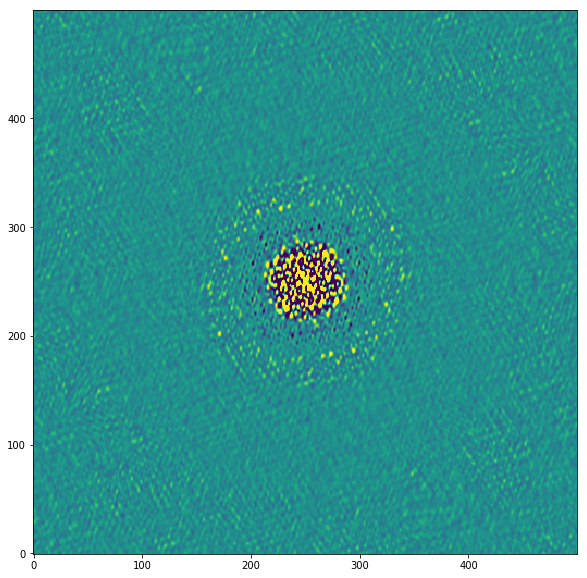

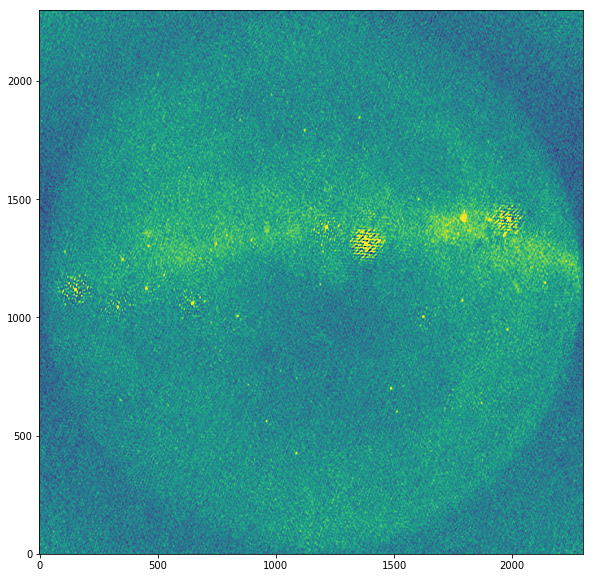

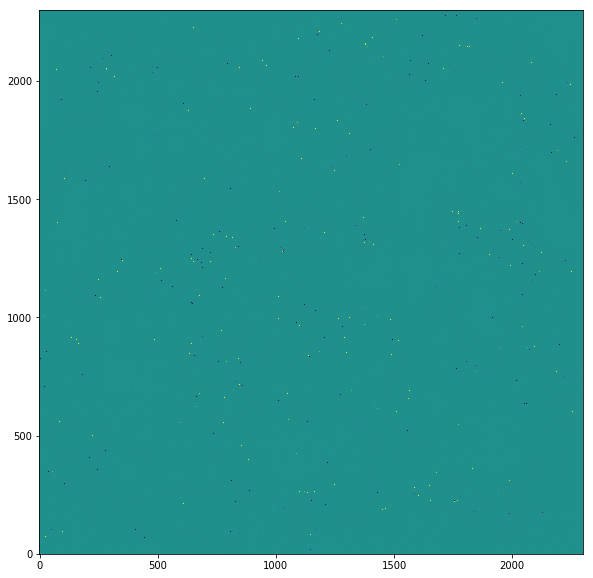

In [87]:
plt.figure(figsize=(10,10))
plt.imshow(psf_resize[900:1400,900:1400], 
           vmin=np.mean(psf)-5*np.std(psf),
           vmax=np.mean(psf)+5*np.std(psf),
           origin="lower")

plt.figure(figsize=(10,10))
plt.imshow(star, 
           vmin=np.mean(star)-5*np.std(star),
           vmax=np.mean(star)+5*np.std(star), 
           origin="lower")

plt.figure(figsize=(10,10))
plt.imshow(decon, 
#            vmin=np.mean(decon)-5*np.std(decon),
#            vmax=np.mean(decon)+5*np.std(decon), 
           origin="lower")

In [74]:
decon[0]

array([[-0.0017944 , -0.01230072, -0.0198888 , ...,  0.01706137,
         0.01694429,  0.00095062],
       [-0.00096673, -0.01220739, -0.01819228, ...,  0.01617601,
         0.01917658,  0.00131629],
       [ 0.00415635, -0.00737535, -0.01667155, ...,  0.01614864,
         0.0190654 ,  0.00368873],
       ...,
       [-0.02176935, -0.02487586, -0.02876296, ...,  0.01168994,
         0.00482875, -0.00601522],
       [-0.01277332, -0.01833734, -0.02489736, ...,  0.01565078,
         0.01086078, -0.0023357 ],
       [-0.01327196, -0.02085398, -0.02593991, ...,  0.01249338,
         0.01188607, -0.00471385]])